## Detecção de Objetos


## Datasets para detecção de objetos
* Uma base muito famosa para realizar tais identificações é chamada coco dataset http://cocodataset.org/#home
    * Essa iniciativa implementa bases com anotações
    * Explorando dataset http://cocodataset.org/#explore
    
* Anotações nesse cenário são segmentações de objetos na imagem
* Informações textuais também são utilizadas para identificar informações como posicionamento na imagem

## Rede neural para detecção de objetos
* A primeira fase é identificar as regiões de interesse
    * Uma camada usada nessa fase é chamada ROi Pooling (Region of Interest)
    
* Selective Search (Algortimo para identificar regiões de interesse)
    * Comece com muitas regiões iniciais minúsculas.
    * Localize as duas regiões mais semelhantes e junte-as.
    * Continue mesclando regiões até que tudo esteja combinado.
    
* Após Encontrar regiões de interesse é feita uma classificção com Convolução

* Em seguida duas etapas são realizadas em paraleo
    * Regressão para identificar o retângulo da imagem
    * classificação da categoria de cada imagem identificada


## Objetivo da rede neural 
* Identificar regiões de interesse 
* A partir da região de interesse identificada classificar cada objeto interno a região de interesse

* Carregando modelo treinado em pytorch usando resnet

In [47]:
from PIL import Image

import cv2

import torchvision.transforms as T
import matplotlib.pyplot as plt 
import torchvision

model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)
model.eval()
import pytorch
print(torchvision.__version__)


0.5.0


## Padrão de nomes de categorias identificadas na imagem (Coco Dataset)
* Uma base muito famosa para realizar tais identificações é chamada coco dataset http://cocodataset.org/#home
    * Essa iniciativa implementa bases com diferentes formatos de anotação
* A seguir criamos uma variável com as categorias definidas no dataset coco dataset
    * Tais categorias serão usadas para inferência com redes treinadas

## Explorando coco dataset
http://cocodataset.org/#explore

In [48]:
COCO_INSTANCE_CATEGORY_NAMES = [
    '__background__', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus',
    'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'N/A', 'stop sign',
    'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow',
    'elephant', 'bear', 'zebra', 'giraffe', 'N/A', 'backpack', 'umbrella', 'N/A', 'N/A',
    'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball',
    'kite', 'baseball bat', 'baseball glove', 'skateboard', 'surfboard', 'tennis racket',
    'bottle', 'N/A', 'wine glass', 'cup', 'fork', 'knife', 'spoon', 'bowl',
    'banana', 'apple', 'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza',
    'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed', 'N/A', 'dining table',
    'N/A', 'N/A', 'toilet', 'N/A', 'tv', 'laptop', 'mouse', 'remote', 'keyboard', 'cell phone',
    'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'N/A', 'book',
    'clock', 'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush'
]

## Utilizar um modelo pré-treinando para fazer predição 
* Desenvolvido com base em pytorch
* Utiliza um limiar de certeza de classificação de objeto

## Transformar imagem para tensor ( estrutura de dados PyTorch)

In [54]:
img = Image.open("people.jpg") 
# cria um objeto para representar um objeto como tensor  
# Estrutura similar a numpy usada pelo PyTorch
# O código abaixo cria uma função que recebe uma matriz e gera um matriz no formato tensor aceito pelo pytorch  
transform = T.Compose([T.ToTensor()]) 
#aplica a função na imagem
print ( img)  
img = transform(img) 
print ( img)  


<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=2000x1333 at 0x7F71F3E8ACD0>
tensor([[[0.9373, 0.9373, 0.9412,  ..., 0.8627, 0.8627, 0.8627],
         [0.9373, 0.9373, 0.9412,  ..., 0.8627, 0.8627, 0.8627],
         [0.9373, 0.9373, 0.9412,  ..., 0.8627, 0.8627, 0.8627],
         ...,
         [0.4157, 0.4314, 0.4353,  ..., 0.4745, 0.4784, 0.4863],
         [0.4549, 0.4706, 0.4863,  ..., 0.4863, 0.4706, 0.4588],
         [0.4431, 0.5098, 0.5216,  ..., 0.4314, 0.4588, 0.4471]],

        [[0.9373, 0.9373, 0.9412,  ..., 0.8588, 0.8588, 0.8588],
         [0.9373, 0.9373, 0.9412,  ..., 0.8588, 0.8588, 0.8588],
         [0.9373, 0.9373, 0.9412,  ..., 0.8588, 0.8588, 0.8588],
         ...,
         [0.3961, 0.4118, 0.4157,  ..., 0.4745, 0.4706, 0.4784],
         [0.4353, 0.4510, 0.4667,  ..., 0.4784, 0.4627, 0.4510],
         [0.4235, 0.4902, 0.5020,  ..., 0.4235, 0.4510, 0.4392]],

        [[0.9373, 0.9373, 0.9412,  ..., 0.8510, 0.8510, 0.8510],
         [0.9373, 0.9373, 0.9412,  ...,

In [79]:
def get_prediction(img_path, threshold):
  # carrega a imagem usando componente PIL  
  img = Image.open(img_path) 
  # cria um objeto para representar um objeto como tensor  
  # Estrutura similar a numpy usada pelo PyTorch
  # O código abaixo cria uma função que recebe uma matriz e gera um matriz no formato tensor aceito pelo pytorch  
  transform = T.Compose([T.ToTensor()]) 
  #aplica a função na imagem
  img = transform(img) 
  # realiza predição com modelo treinado, passando a imagem como entrada  
  pred = model([img]) 
  # O objeto pred criado contém uma lista com todos os lables identidicados
  # o objeto pred_class armazena a categoria encontrada
  pred_class = [COCO_INSTANCE_CATEGORY_NAMES[i] for i in list(pred[0]['labels'].numpy())] 
  
  print(pred_class)              

  # A função pred_boxes armazena os retangulos encontrados
  pred_boxes = [[(i[0], i[1]), (i[2], i[3])] for i in list(pred[0]['boxes'].detach().numpy())] # Bounding boxes

  # A função pred_score retorna os scores de cada objeto encontrado
  pred_score = list(pred[0]['scores'].detach().numpy())

  ## Obtem índice score maior que limiar passado
  pred_t = [pred_score.index(x) for x in pred_score if x > threshold][-1] 
  ## Seleciona apenas as predições acima do limiar passado
  pred_boxes = pred_boxes[:pred_t+1]
  pred_class = pred_class[:pred_t+1]
  return pred_boxes, pred_class

## Função que carrega a imagem, faz a predição obtendo classes e retangulos com objetos
* Em seguida usa openCV para desenhar os retangulos

In [57]:
def object_detection_api(img_path, threshold=0.5, rect_th=3, text_size=3, text_th=3):

  boxes, pred_cls = get_prediction(img_path, threshold) 
  img = cv2.imread(img_path) 
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) 
  # percorre retangulo encontrados
  for i in range(len(boxes)):
    # desenha o retangulo na imagem passada  
    cv2.rectangle(img, boxes[i][0], boxes[i][1],color=(0, 255, 0), thickness=rect_th) # Draw Rectangle with the coordinates
    cv2.putText(img,pred_cls[i], boxes[i][0],  cv2.FONT_HERSHEY_SIMPLEX, text_size, (0,255,0),thickness=text_th) # Write the prediction class
  plt.figure(figsize=(20,30)) # display the output image
  plt.imshow(img)
  plt.xticks([])
  plt.yticks([])
  plt.show()


## Alguns testes 

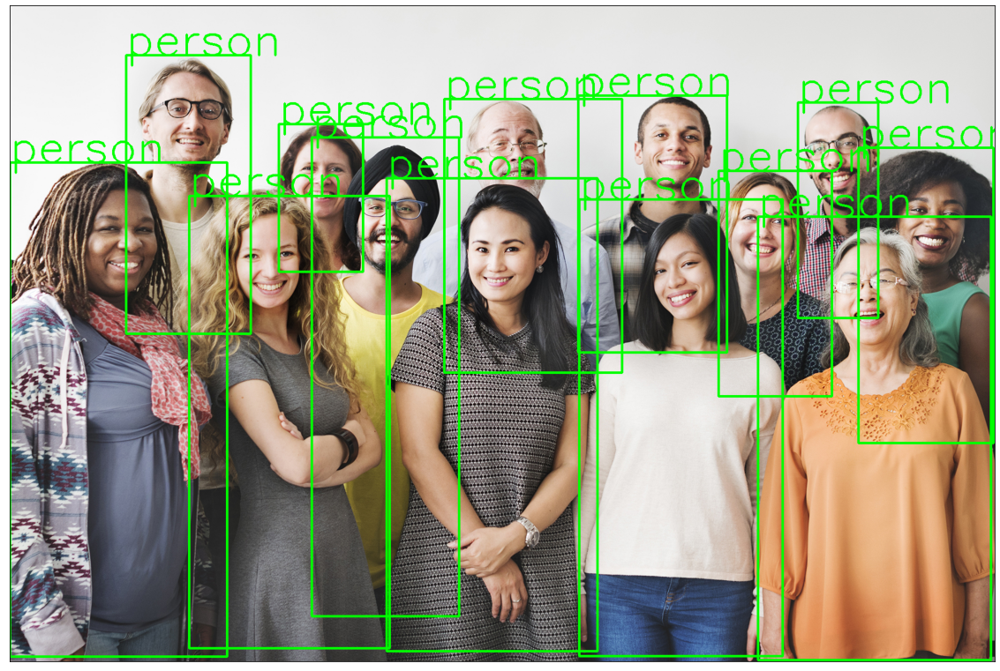

In [58]:
#!wget https://www.wsha.org/wp-content/uploads/banner-diverse-group-of-people-2.jpg -O people.jpg
object_detection_api('./people.jpg', threshold=0.8)

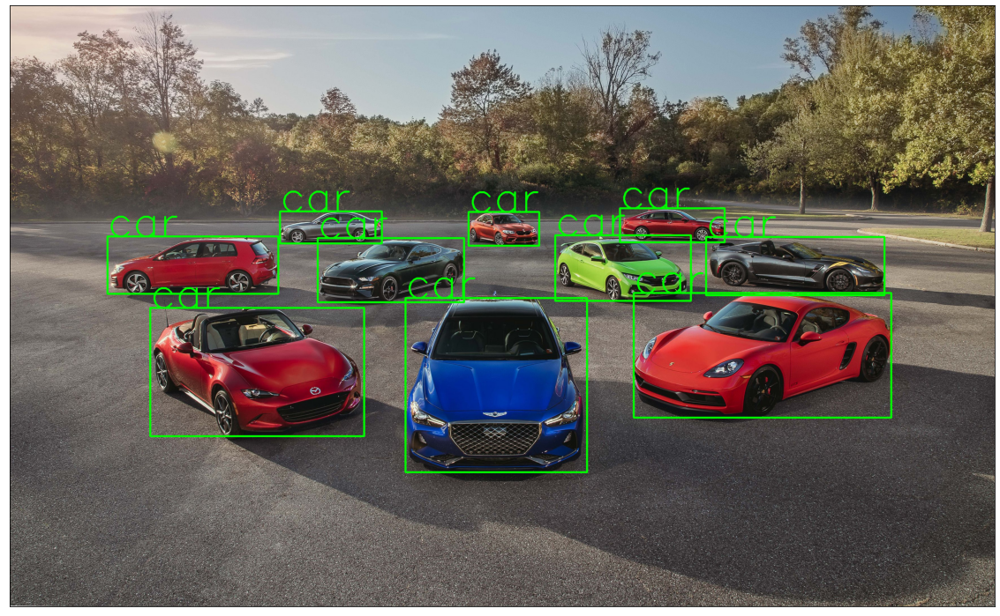

In [59]:
#!wget https://hips.hearstapps.com/hmg-prod.s3.amazonaws.com/images/10best-cars-group-cropped-1542126037.jpg -O car.jpg
object_detection_api('./car.jpg', rect_th=6, text_th=5, text_size=5)

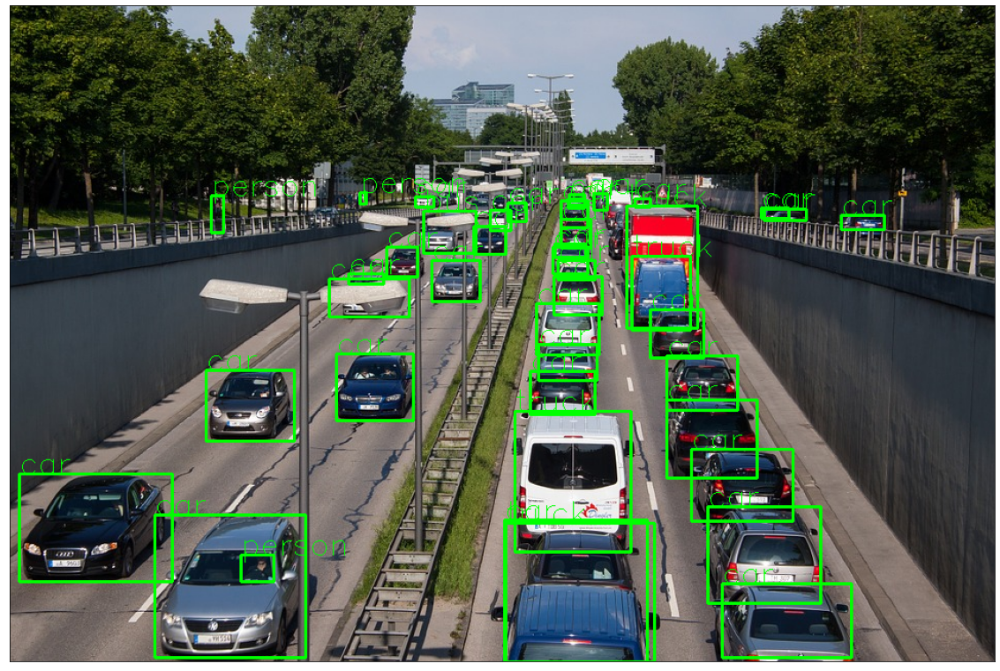

In [60]:
#!wget https://cdn.pixabay.com/photo/2013/07/05/01/08/traffic-143391_960_720.jpg -O traffic.jpg

object_detection_api('./traffic.jpg', rect_th=2, text_th=1, text_size=1)

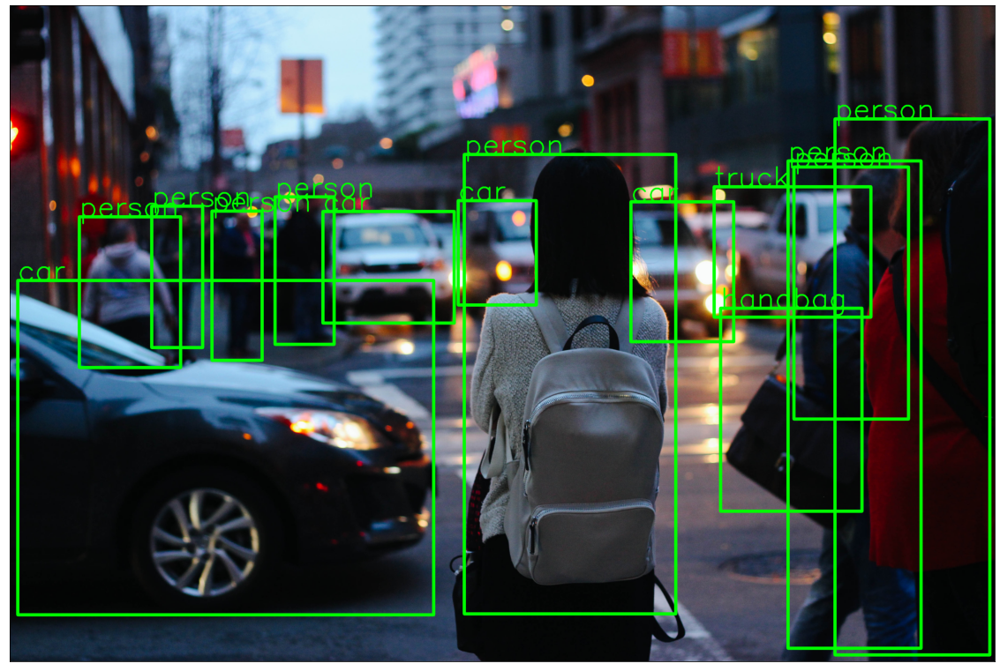

In [61]:
#!wget https://images.unsplash.com/photo-1458169495136-854e4c39548a -O girl_cars.jpg

object_detection_api('./girl_cars.jpg', rect_th=15, text_th=7, text_size=5, threshold=0.8)  

## Dataset com imagem de pedestres (https://www.cis.upenn.edu/~jshi/ped_html/)

* Aplicando conceito de transfer learning para identificar pedestres em uma imagem
* Vantagens
    * Maior velocidade no processo de treino
    * Reutilização da capacidade da rede de identificação de região de interesse

In [43]:
!ls /home/silvio/git/datasets/penn/PennFudanPed/PNGImages/

FudanPed00001.png  FudanPed00044.png  PennPed00013.png	PennPed00056.png
FudanPed00002.png  FudanPed00045.png  PennPed00014.png	PennPed00057.png
FudanPed00003.png  FudanPed00046.png  PennPed00015.png	PennPed00058.png
FudanPed00004.png  FudanPed00047.png  PennPed00016.png	PennPed00059.png
FudanPed00005.png  FudanPed00048.png  PennPed00017.png	PennPed00060.png
FudanPed00006.png  FudanPed00049.png  PennPed00018.png	PennPed00061.png
FudanPed00007.png  FudanPed00050.png  PennPed00019.png	PennPed00062.png
FudanPed00008.png  FudanPed00051.png  PennPed00020.png	PennPed00063.png
FudanPed00009.png  FudanPed00052.png  PennPed00021.png	PennPed00064.png
FudanPed00010.png  FudanPed00053.png  PennPed00022.png	PennPed00065.png
FudanPed00011.png  FudanPed00054.png  PennPed00023.png	PennPed00066.png
FudanPed00012.png  FudanPed00055.png  PennPed00024.png	PennPed00067.png
FudanPed00013.png  FudanPed00056.png  PennPed00025.png	PennPed00068.png
FudanPed00014.png  FudanPed00057.png  PennPed00026.png	PennPed00

['person', 'person', 'tie', 'tie', 'tie']


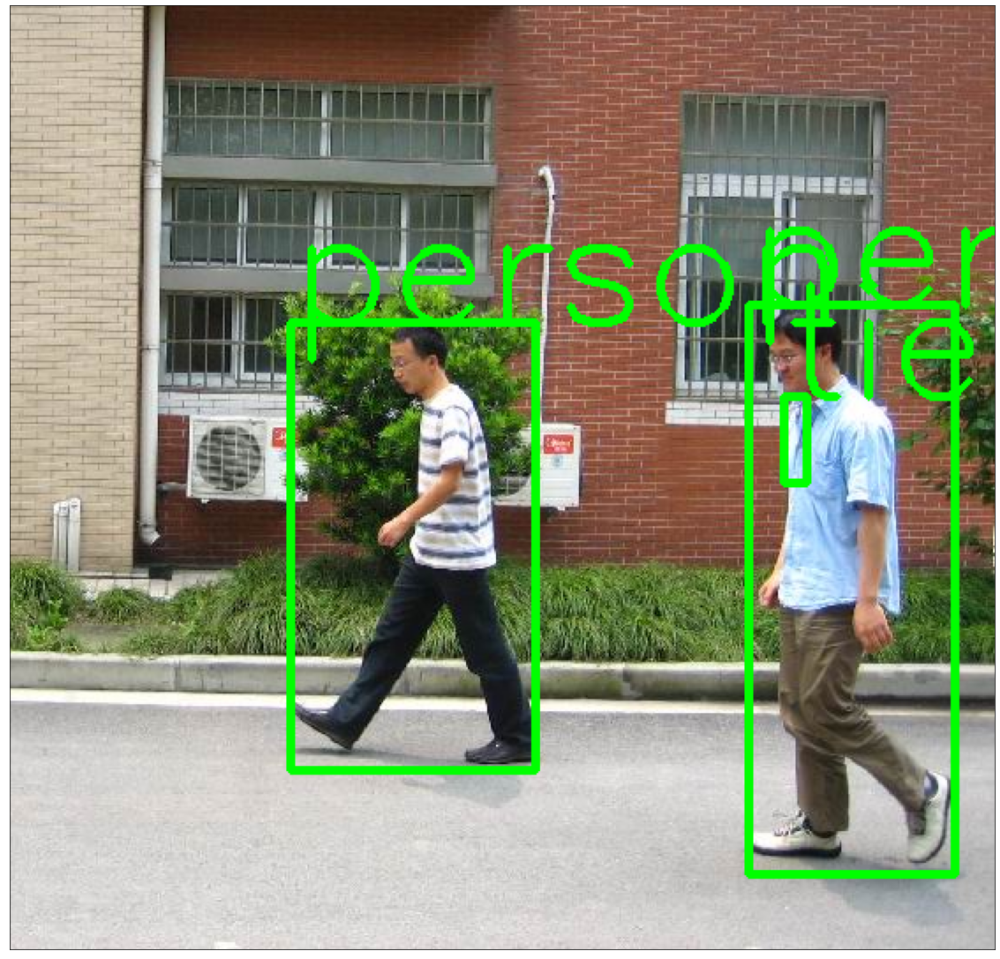

In [81]:
#object_detection_api('/home/silvio/git/datasets/penn/PennFudanPed/PNGImages/PennPed00096.png', threshold=0.8)
#object_detection_api('/home/silvio/git/datasets/penn/PennFudanPed/PNGImages/PennPed00096.png', rect_th=15, text_th=7, text_size=5, threshold=0.8) 
#object_detection_api('/home/silvio/git/datasets/penn/PennFudanPed/PNGImages/PennPed00074.png', threshold=0.8)
object_detection_api('/home/silvio/git/datasets/penn/PennFudanPed/PNGImages/FudanPed00001.png', threshold=0.5)


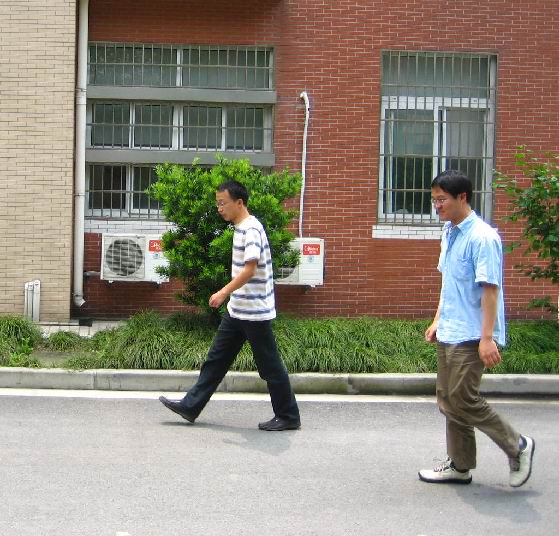

In [82]:
from PIL import Image
Image.open('/home/silvio/git/datasets/penn/PennFudanPed/PNGImages/FudanPed00001.png')

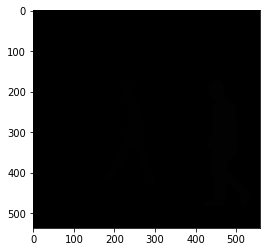

In [114]:
import cv2 as cv
img = cv.imread('/home/silvio/git/datasets/penn/PennFudanPed/PedMasks/FudanPed00001_mask.png')

plt.imshow(img)

### cada instância de máscara tem uma cor diferente, de zero a N
### N é o número de instâncias. 
### adicionando uma paleta de cores à máscara. para facilitar visualização

In [115]:
mask2 = np.array(mask)
print(mask2)
result = np.where(mask2 == 2)
 
print(' : ', result)

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
 :  (array([170, 170, 170, ..., 485, 485, 485]), array([452, 453, 454, ..., 514, 515, 516]))


(559, 536)


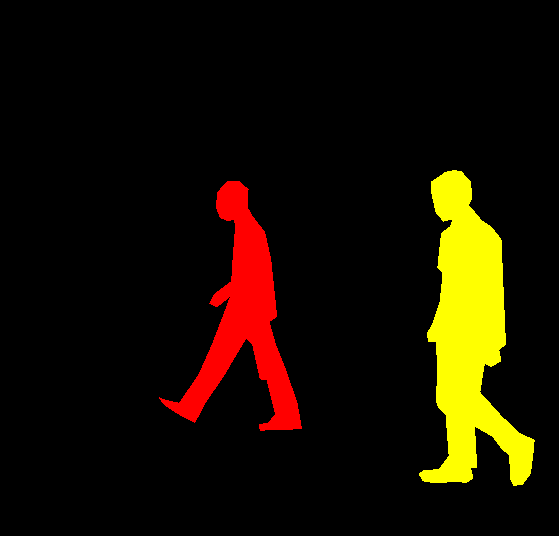

In [102]:
mask = Image.open('/home/silvio/git/datasets/penn/PennFudanPed/PedMasks/FudanPed00001_mask.png')

print(mask.size)
mask.putpalette([
    0, 0, 0, # black background
    255, 0, 0, # index 1 is red
    255, 255, 0, # index 2 is yellow
    255, 153, 0, # index 3 is orange
])
mask


In [103]:
import os
import numpy as np
import torch
import torch.utils.data
from PIL import Image


class PennFudanDataset(torch.utils.data.Dataset):
    def __init__(self, root, transforms=None):
        self.root = root
        self.transforms = transforms
        # Carrega nomes de  imagens e máscaras
        self.imgs = list(sorted(os.listdir(os.path.join(root, "PNGImages"))))
        self.masks = list(sorted(os.listdir(os.path.join(root, "PedMasks"))))

    def __getitem__(self, idx):
        # load images ad masks
        img_path = os.path.join(self.root, "PNGImages", self.imgs[idx])
        mask_path = os.path.join(self.root, "PedMasks", self.masks[idx])
        img = Image.open(img_path).convert("RGB")
        #Carrega máscara como imagem
        mask = Image.open(mask_path)

        mask = np.array(mask)
        ## identifica quantidade de objetos na imagem por meio dos valores únicos na mascara
        obj_ids = np.unique(mask)
        # remove id 0 que é background
        obj_ids = obj_ids[1:]

        # divide a máscara codificada por cores em um conjunto de máscaras binárias
        masks = mask == obj_ids[:, None, None]

        # Rotina para obter o retangulo de cada objeto na máscata
        num_objs = len(obj_ids)
        boxes = []
        for i in range(num_objs):
            pos = np.where(masks[i])
            xmin = np.min(pos[1])
            xmax = np.max(pos[1])
            ymin = np.min(pos[0])
            ymax = np.max(pos[0])
            boxes.append([xmin, ymin, xmax, ymax])

        boxes = torch.as_tensor(boxes, dtype=torch.float32)
        # label é sempre 1 para qualquer objeto encontrado (só há classe pedestres)
        labels = torch.ones((num_objs,), dtype=torch.int64)
        masks = torch.as_tensor(masks, dtype=torch.uint8)

        image_id = torch.tensor([idx])
        area = (boxes[:, 3] - boxes[:, 1]) * (boxes[:, 2] - boxes[:, 0])
        iscrowd = torch.zeros((num_objs,), dtype=torch.int64)

        target = {}
        target["boxes"] = boxes
        target["labels"] = labels
        target["masks"] = masks
        target["image_id"] = image_id
        target["area"] = area
        target["iscrowd"] = iscrowd

        if self.transforms is not None:
            img, target = self.transforms(img, target)

        return img, target

    def __len__(self):
        return len(self.imgs)

In [106]:
dataset = PennFudanDataset('/home/silvio/git/datasets/penn/PennFudanPed')
dataset[2]

(<PIL.Image.Image image mode=RGB size=479x445 at 0x7F6E9C36DB90>,
 {'boxes': tensor([[292., 134., 446., 420.]]),
  'labels': tensor([1]),
  'masks': tensor([[[0, 0, 0,  ..., 0, 0, 0],
           [0, 0, 0,  ..., 0, 0, 0],
           [0, 0, 0,  ..., 0, 0, 0],
           ...,
           [0, 0, 0,  ..., 0, 0, 0],
           [0, 0, 0,  ..., 0, 0, 0],
           [0, 0, 0,  ..., 0, 0, 0]]], dtype=torch.uint8),
  'image_id': tensor([2]),
  'area': tensor([44044.]),
  'iscrowd': tensor([0])})

In [117]:
import torchvision
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision.models.detection.mask_rcnn import MaskRCNNPredictor

      
def get_instance_segmentation_model(num_classes):
    # Carrega modelo pré-treinado
    model = torchvision.models.detection.maskrcnn_resnet50_fpn(pretrained=True)

    # obtém número de categorias da classe principal
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    print(in_features)
    # subtitui pelo número de categorias passo como parâmetro
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

    
    in_features_mask = model.roi_heads.mask_predictor.conv5_mask.in_channels
    print(in_features_mask)
    hidden_layer = 256
    # substitui preditor de máscara
    model.roi_heads.mask_predictor = MaskRCNNPredictor(in_features_mask,
                                                       hidden_layer,
                                                       num_classes)

    return model

In [9]:
from engine import train_one_epoch, evaluate
import utils
import transforms as T

## Função para aplicar data augmentation nas imagens de entrada

In [10]:
from engine import train_one_epoch, evaluate
import utils
import transforms as T

# 
def get_transform(train):
    transforms = []
    # Convert PIL para tensor
    
    transforms.append(T.ToTensor())
    if train:
        # durante treino: aplica data augmentation nas imagens
        transforms.append(T.RandomHorizontalFlip(0.5))
    return T.Compose(transforms)

In [14]:
# use our dataset and defined transformations
dataset = PennFudanDataset('/home/silvio/git/datasets/penn/PennFudanPed/', get_transform(train=True))
dataset_test = PennFudanDataset('/home/silvio/git/datasets/penn/PennFudanPed/', get_transform(train=False))

# separa em treino e teste
torch.manual_seed(1)
indices = torch.randperm(len(dataset)).tolist()
dataset = torch.utils.data.Subset(dataset, indices[:-50])
dataset_test = torch.utils.data.Subset(dataset_test, indices[-50:])

# training and validation data loaders
data_loader = torch.utils.data.DataLoader(
    dataset, batch_size=2, shuffle=True, num_workers=4,
    collate_fn=utils.collate_fn)

data_loader_test = torch.utils.data.DataLoader(
    dataset_test, batch_size=1, shuffle=False, num_workers=4,
    collate_fn=utils.collate_fn)

In [122]:
#utiliza variável device para determinar se modelo roda em GPU ou CPU
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

# dataset possui apenas duas classes fundo e pessoa
num_classes = 2

# cria o modelo usanso transfer learning
model = get_instance_segmentation_model(num_classes)
# indica que treino tem que ser feito no device escolhido (CPU ou GPU)
model.to(device)

# construct an optimizer
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=0.005,
                            momentum=0.9, weight_decay=0.0005)

# and a learning rate scheduler which decreases the learning rate by
# 10x every 3 epochs
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer,
                                               step_size=3,
                                               gamma=0.1)

1024
256


## Avaliação do modelo
* IoU (Intersection over union)

In [123]:
# let's train it for 10 epochs
num_epochs = 10

for epoch in range(num_epochs):
    # train for one epoch, printing every 10 iterations
    train_one_epoch(model, optimizer, data_loader, device, epoch, print_freq=10)
    # update the learning rate
    lr_scheduler.step()
    # evaluate on the test dataset
    evaluate(model, data_loader_test, device=device)

Epoch: [0]  [ 0/60]  eta: 0:00:51  lr: 0.000090  loss: 3.2352 (3.2352)  loss_classifier: 0.6423 (0.6423)  loss_box_reg: 0.2149 (0.2149)  loss_mask: 2.3392 (2.3392)  loss_objectness: 0.0274 (0.0274)  loss_rpn_box_reg: 0.0115 (0.0115)  time: 0.8644  data: 0.6291  max mem: 3817
Epoch: [0]  [10/60]  eta: 0:00:15  lr: 0.000936  loss: 1.4214 (1.8558)  loss_classifier: 0.3939 (0.4322)  loss_box_reg: 0.1635 (0.1716)  loss_mask: 0.9258 (1.2167)  loss_objectness: 0.0179 (0.0254)  loss_rpn_box_reg: 0.0096 (0.0099)  time: 0.3054  data: 0.0625  max mem: 3817
Epoch: [0]  [20/60]  eta: 0:00:11  lr: 0.001783  loss: 0.8936 (1.2797)  loss_classifier: 0.2442 (0.3150)  loss_box_reg: 0.1573 (0.1737)  loss_mask: 0.3834 (0.7569)  loss_objectness: 0.0123 (0.0213)  loss_rpn_box_reg: 0.0096 (0.0128)  time: 0.2511  data: 0.0058  max mem: 3979
Epoch: [0]  [30/60]  eta: 0:00:08  lr: 0.002629  loss: 0.4611 (1.0027)  loss_classifier: 0.0975 (0.2391)  loss_box_reg: 0.1355 (0.1584)  loss_mask: 0.2074 (0.5774)  loss_ob

Epoch: [2]  [ 0/60]  eta: 0:00:54  lr: 0.005000  loss: 0.2749 (0.2749)  loss_classifier: 0.0476 (0.0476)  loss_box_reg: 0.0352 (0.0352)  loss_mask: 0.1787 (0.1787)  loss_objectness: 0.0011 (0.0011)  loss_rpn_box_reg: 0.0124 (0.0124)  time: 0.9068  data: 0.6408  max mem: 3979
Epoch: [2]  [10/60]  eta: 0:00:15  lr: 0.005000  loss: 0.1846 (0.2123)  loss_classifier: 0.0411 (0.0370)  loss_box_reg: 0.0167 (0.0251)  loss_mask: 0.1146 (0.1346)  loss_objectness: 0.0008 (0.0012)  loss_rpn_box_reg: 0.0124 (0.0142)  time: 0.3148  data: 0.0635  max mem: 3979
Epoch: [2]  [20/60]  eta: 0:00:11  lr: 0.005000  loss: 0.1765 (0.1951)  loss_classifier: 0.0293 (0.0323)  loss_box_reg: 0.0160 (0.0213)  loss_mask: 0.1146 (0.1273)  loss_objectness: 0.0007 (0.0013)  loss_rpn_box_reg: 0.0106 (0.0129)  time: 0.2517  data: 0.0058  max mem: 3979
Epoch: [2]  [30/60]  eta: 0:00:08  lr: 0.005000  loss: 0.1876 (0.1916)  loss_classifier: 0.0293 (0.0318)  loss_box_reg: 0.0168 (0.0203)  loss_mask: 0.1164 (0.1254)  loss_ob

Epoch: [4]  [ 0/60]  eta: 0:00:54  lr: 0.000500  loss: 0.1684 (0.1684)  loss_classifier: 0.0298 (0.0298)  loss_box_reg: 0.0089 (0.0089)  loss_mask: 0.1235 (0.1235)  loss_objectness: 0.0002 (0.0002)  loss_rpn_box_reg: 0.0060 (0.0060)  time: 0.9120  data: 0.6601  max mem: 3979
Epoch: [4]  [10/60]  eta: 0:00:14  lr: 0.000500  loss: 0.1321 (0.1428)  loss_classifier: 0.0172 (0.0215)  loss_box_reg: 0.0055 (0.0088)  loss_mask: 0.1050 (0.1065)  loss_objectness: 0.0002 (0.0008)  loss_rpn_box_reg: 0.0047 (0.0053)  time: 0.2997  data: 0.0638  max mem: 3979
Epoch: [4]  [20/60]  eta: 0:00:11  lr: 0.000500  loss: 0.1452 (0.1511)  loss_classifier: 0.0202 (0.0232)  loss_box_reg: 0.0076 (0.0102)  loss_mask: 0.1051 (0.1103)  loss_objectness: 0.0003 (0.0007)  loss_rpn_box_reg: 0.0063 (0.0067)  time: 0.2492  data: 0.0050  max mem: 3979
Epoch: [4]  [30/60]  eta: 0:00:08  lr: 0.000500  loss: 0.1516 (0.1542)  loss_classifier: 0.0214 (0.0227)  loss_box_reg: 0.0103 (0.0103)  loss_mask: 0.1099 (0.1133)  loss_ob

Epoch: [6]  [ 0/60]  eta: 0:00:59  lr: 0.000050  loss: 0.1668 (0.1668)  loss_classifier: 0.0420 (0.0420)  loss_box_reg: 0.0106 (0.0106)  loss_mask: 0.1008 (0.1008)  loss_objectness: 0.0009 (0.0009)  loss_rpn_box_reg: 0.0126 (0.0126)  time: 0.9983  data: 0.6925  max mem: 3979
Epoch: [6]  [10/60]  eta: 0:00:15  lr: 0.000050  loss: 0.1490 (0.1529)  loss_classifier: 0.0240 (0.0228)  loss_box_reg: 0.0060 (0.0090)  loss_mask: 0.1082 (0.1126)  loss_objectness: 0.0003 (0.0006)  loss_rpn_box_reg: 0.0083 (0.0079)  time: 0.3152  data: 0.0678  max mem: 3979
Epoch: [6]  [20/60]  eta: 0:00:11  lr: 0.000050  loss: 0.1468 (0.1575)  loss_classifier: 0.0189 (0.0244)  loss_box_reg: 0.0063 (0.0112)  loss_mask: 0.1082 (0.1134)  loss_objectness: 0.0003 (0.0006)  loss_rpn_box_reg: 0.0068 (0.0080)  time: 0.2523  data: 0.0055  max mem: 3979
Epoch: [6]  [30/60]  eta: 0:00:08  lr: 0.000050  loss: 0.1464 (0.1603)  loss_classifier: 0.0221 (0.0248)  loss_box_reg: 0.0083 (0.0107)  loss_mask: 0.1110 (0.1157)  loss_ob

Epoch: [8]  [ 0/60]  eta: 0:00:53  lr: 0.000050  loss: 0.1332 (0.1332)  loss_classifier: 0.0120 (0.0120)  loss_box_reg: 0.0053 (0.0053)  loss_mask: 0.1082 (0.1082)  loss_objectness: 0.0008 (0.0008)  loss_rpn_box_reg: 0.0070 (0.0070)  time: 0.8974  data: 0.6422  max mem: 3979
Epoch: [8]  [10/60]  eta: 0:00:15  lr: 0.000050  loss: 0.1455 (0.1512)  loss_classifier: 0.0228 (0.0230)  loss_box_reg: 0.0082 (0.0091)  loss_mask: 0.1081 (0.1126)  loss_objectness: 0.0003 (0.0009)  loss_rpn_box_reg: 0.0050 (0.0057)  time: 0.3168  data: 0.0642  max mem: 3979
Epoch: [8]  [20/60]  eta: 0:00:11  lr: 0.000050  loss: 0.1455 (0.1581)  loss_classifier: 0.0228 (0.0243)  loss_box_reg: 0.0086 (0.0110)  loss_mask: 0.1055 (0.1148)  loss_objectness: 0.0004 (0.0008)  loss_rpn_box_reg: 0.0050 (0.0072)  time: 0.2573  data: 0.0060  max mem: 3979
Epoch: [8]  [30/60]  eta: 0:00:08  lr: 0.000050  loss: 0.1407 (0.1581)  loss_classifier: 0.0224 (0.0241)  loss_box_reg: 0.0079 (0.0111)  loss_mask: 0.1033 (0.1150)  loss_ob

In [128]:
print(dataset_test[49])

(tensor([[[0.1020, 0.1843, 0.1569,  ..., 0.0588, 0.0510, 0.0706],
         [0.1373, 0.1490, 0.0941,  ..., 0.0784, 0.1059, 0.0039],
         [0.1412, 0.1569, 0.1451,  ..., 0.0118, 0.0863, 0.1451],
         ...,
         [0.6118, 0.6157, 0.6157,  ..., 0.5059, 0.5098, 0.5529],
         [0.5451, 0.5490, 0.5569,  ..., 0.5294, 0.5294, 0.5294],
         [0.5333, 0.5373, 0.5412,  ..., 0.6039, 0.6039, 0.6157]],

        [[0.1843, 0.2667, 0.2392,  ..., 0.0667, 0.0667, 0.0902],
         [0.2196, 0.2314, 0.1765,  ..., 0.0863, 0.1255, 0.0314],
         [0.2314, 0.2471, 0.2353,  ..., 0.0431, 0.1294, 0.1882],
         ...,
         [0.6471, 0.6510, 0.6510,  ..., 0.4353, 0.4392, 0.4824],
         [0.5804, 0.5843, 0.5922,  ..., 0.4667, 0.4667, 0.4667],
         [0.5686, 0.5725, 0.5765,  ..., 0.5490, 0.5490, 0.5608]],

        [[0.0157, 0.0980, 0.0706,  ..., 0.0627, 0.0627, 0.0745],
         [0.0510, 0.0627, 0.0078,  ..., 0.0745, 0.1020, 0.0039],
         [0.0588, 0.0745, 0.0627,  ..., 0.0000, 0.0745, 0

In [129]:
# Obtem uma imagem do dataset
img, _ = dataset_test[49]
# put the model in evaluation mode
model.eval()
with torch.no_grad():
    prediction = model([img.to(device)])

In [130]:
prediction

[{'boxes': tensor([[ 72.9009,  56.1075, 176.9610, 347.1988]], device='cuda:0'),
  'labels': tensor([1], device='cuda:0'),
  'scores': tensor([0.9991], device='cuda:0'),
  'masks': tensor([[[[0., 0., 0.,  ..., 0., 0., 0.],
            [0., 0., 0.,  ..., 0., 0., 0.],
            [0., 0., 0.,  ..., 0., 0., 0.],
            ...,
            [0., 0., 0.,  ..., 0., 0., 0.],
            [0., 0., 0.,  ..., 0., 0., 0.],
            [0., 0., 0.,  ..., 0., 0., 0.]]]], device='cuda:0')}]

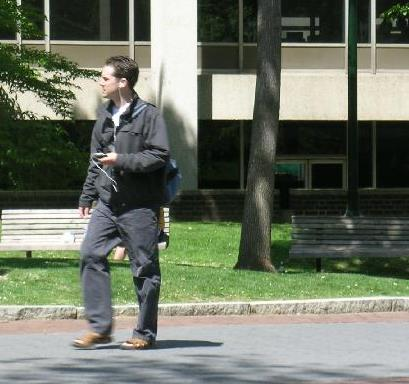

In [131]:
Image.fromarray(img.mul(255).permute(1, 2, 0).byte().numpy())

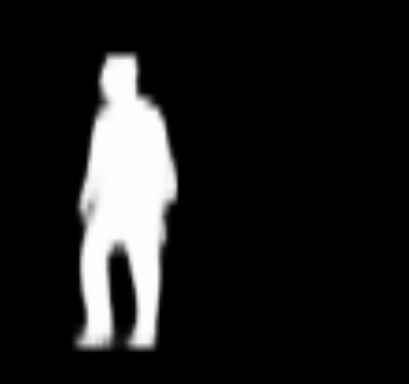

In [132]:
Image.fromarray(prediction[0]['masks'][0, 0].mul(255).byte().cpu().numpy())

In [149]:
img2 = Image.open('/home/silvio/git/introducao-CNN/6.jpg') 
transform = T.Compose([T.ToTensor()]) 
img22 = transform(img2) 

model.eval()
with torch.no_grad():
    prediction = model([img22.to(device)])

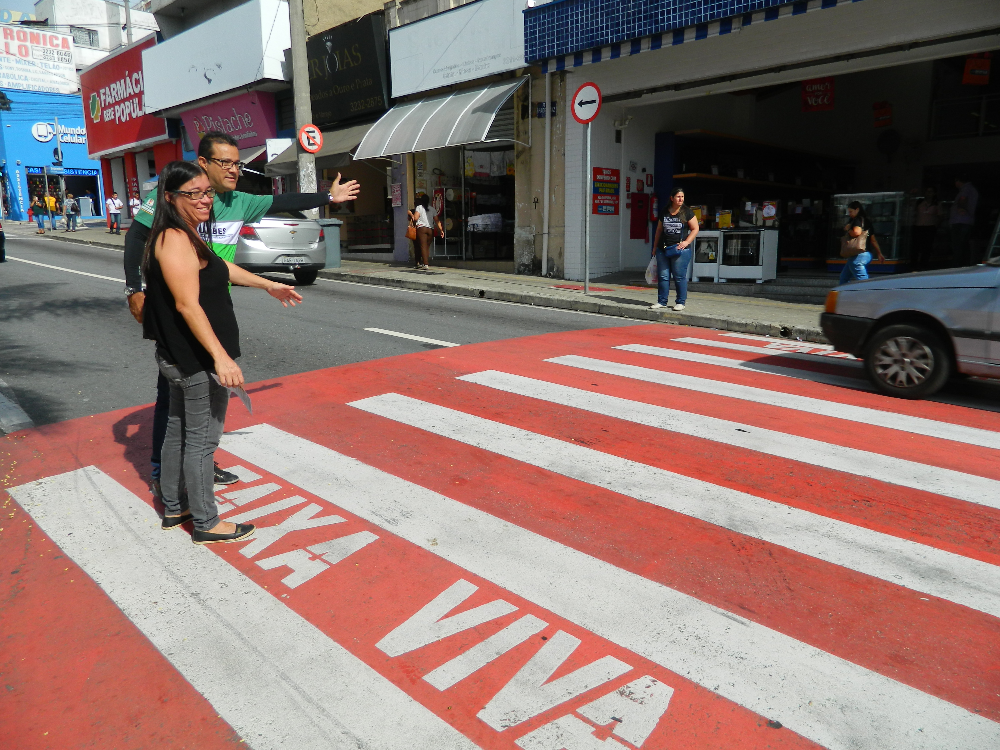

In [150]:
Image.fromarray(img22.mul(255).permute(1, 2, 0).byte().numpy())

In [153]:
prediction

[{'boxes': tensor([[ 584.0447,  665.4415, 1210.1614, 2359.5764],
          [2808.1570,  809.3864, 3015.1899, 1324.4369],
          [1762.3306,  833.0193, 1877.6940, 1151.9800],
          [ 463.1379,  827.0685,  525.3561, 1004.3118],
          [ 285.9779,  835.2144,  338.0527,  989.2219],
          [3618.1509,  868.2347, 3802.2671, 1235.0193],
          [ 129.6820,  827.1548,  222.6209,  997.0268],
          [ 204.1145,  819.8926,  247.5817,  980.4074],
          [1753.2405,  869.6956, 1819.3043, 1143.3750]], device='cuda:0'),
  'labels': tensor([1, 1, 1, 1, 1, 1, 1, 1, 1], device='cuda:0'),
  'scores': tensor([0.9979, 0.9973, 0.9863, 0.8839, 0.5138, 0.3195, 0.1686, 0.1629, 0.1456],
         device='cuda:0'),
  'masks': tensor([[[[0., 0., 0.,  ..., 0., 0., 0.],
            [0., 0., 0.,  ..., 0., 0., 0.],
            [0., 0., 0.,  ..., 0., 0., 0.],
            ...,
            [0., 0., 0.,  ..., 0., 0., 0.],
            [0., 0., 0.,  ..., 0., 0., 0.],
            [0., 0., 0.,  ..., 0., 0

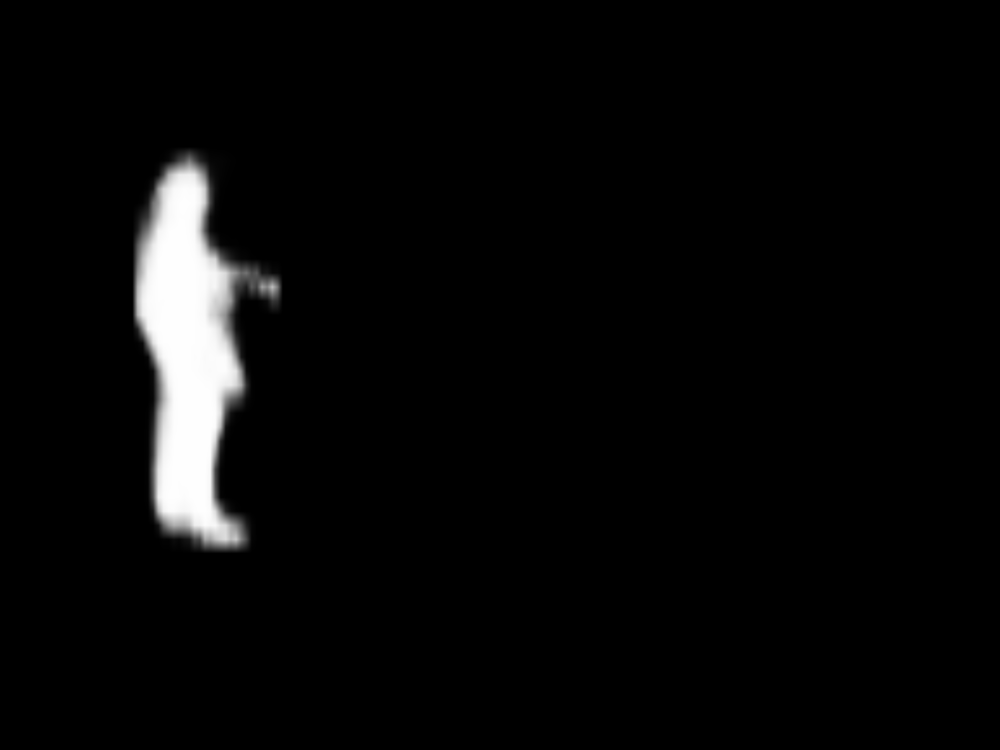

In [151]:
Image.fromarray(prediction[0]['masks'][0, 0].mul(255).byte().cpu().numpy())

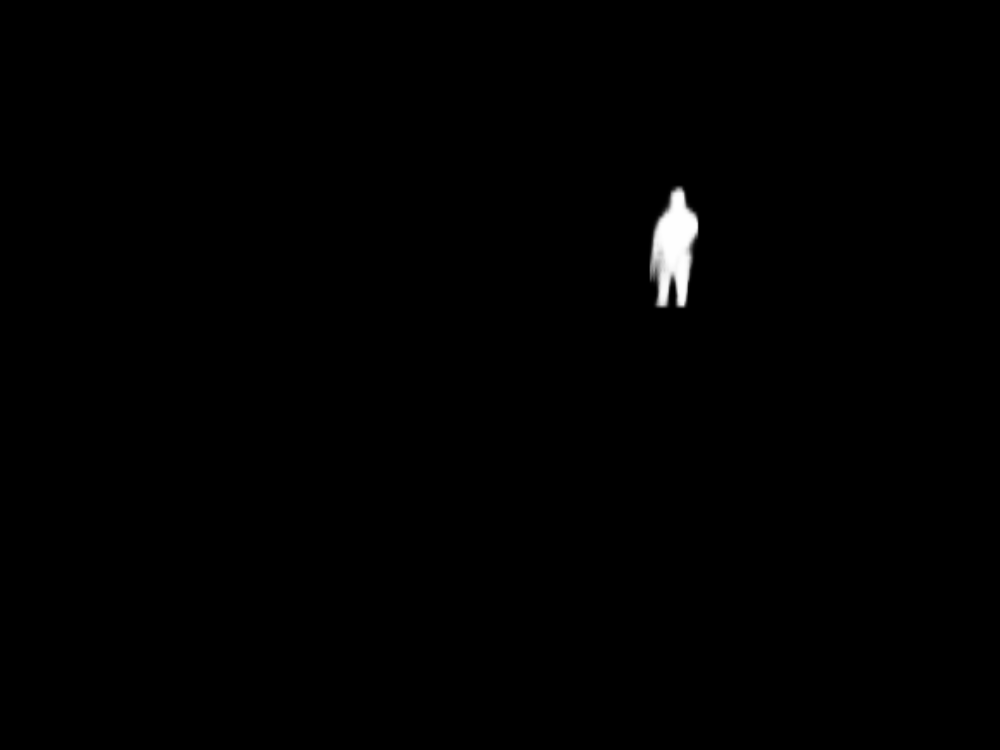

In [152]:
Image.fromarray(prediction[0]['masks'][1, 0].mul(255).byte().cpu().numpy())

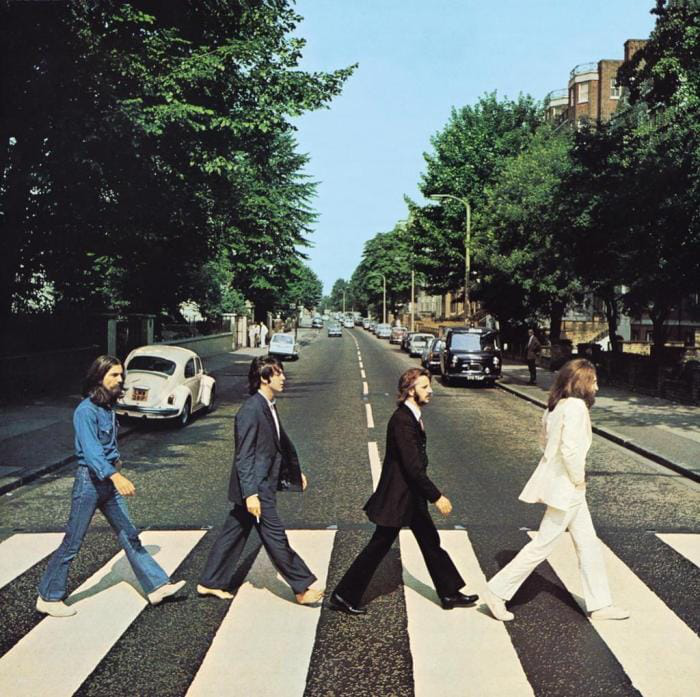

In [154]:
Image.open('/home/silvio/git/introducao-CNN/abey-road.jpg')

In [155]:
img2 = Image.open('/home/silvio/git/introducao-CNN/abey-road.jpg') 
transform = T.Compose([T.ToTensor()]) 
img22 = transform(img2) 

model.eval()
with torch.no_grad():
    prediction = model([img22.to(device)])

In [156]:
prediction

[{'boxes': tensor([[ 40.8148, 353.3356, 169.1090, 602.2112],
          [201.3901, 351.8432, 313.8391, 603.5663],
          [332.8162, 370.0363, 469.2471, 631.7069],
          [488.9501, 354.3273, 634.2160, 639.1526],
          [526.5420, 325.8710, 542.5038, 381.7944],
          [245.3327, 345.1466, 458.0107, 608.9449]], device='cuda:0'),
  'labels': tensor([1, 1, 1, 1, 1, 1], device='cuda:0'),
  'scores': tensor([0.9958, 0.9952, 0.9832, 0.9785, 0.8040, 0.0941], device='cuda:0'),
  'masks': tensor([[[[0., 0., 0.,  ..., 0., 0., 0.],
            [0., 0., 0.,  ..., 0., 0., 0.],
            [0., 0., 0.,  ..., 0., 0., 0.],
            ...,
            [0., 0., 0.,  ..., 0., 0., 0.],
            [0., 0., 0.,  ..., 0., 0., 0.],
            [0., 0., 0.,  ..., 0., 0., 0.]]],
  
  
          [[[0., 0., 0.,  ..., 0., 0., 0.],
            [0., 0., 0.,  ..., 0., 0., 0.],
            [0., 0., 0.,  ..., 0., 0., 0.],
            ...,
            [0., 0., 0.,  ..., 0., 0., 0.],
            [0., 0., 0., 

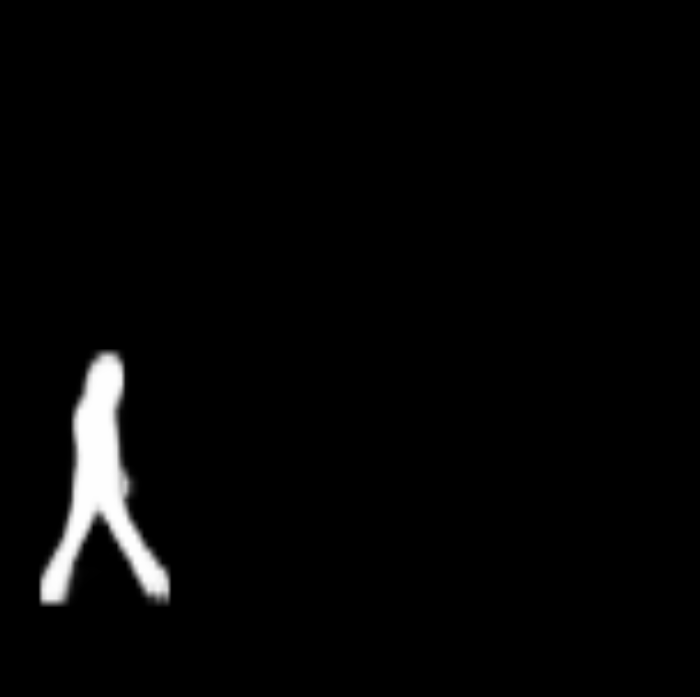

In [157]:
Image.fromarray(prediction[0]['masks'][0, 0].mul(255).byte().cpu().numpy())

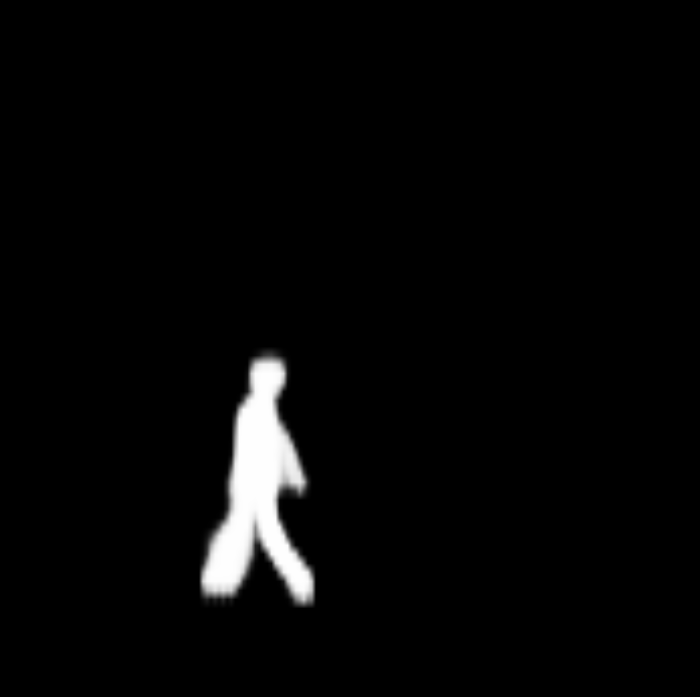

In [158]:
Image.fromarray(prediction[0]['masks'][1, 0].mul(255).byte().cpu().numpy())

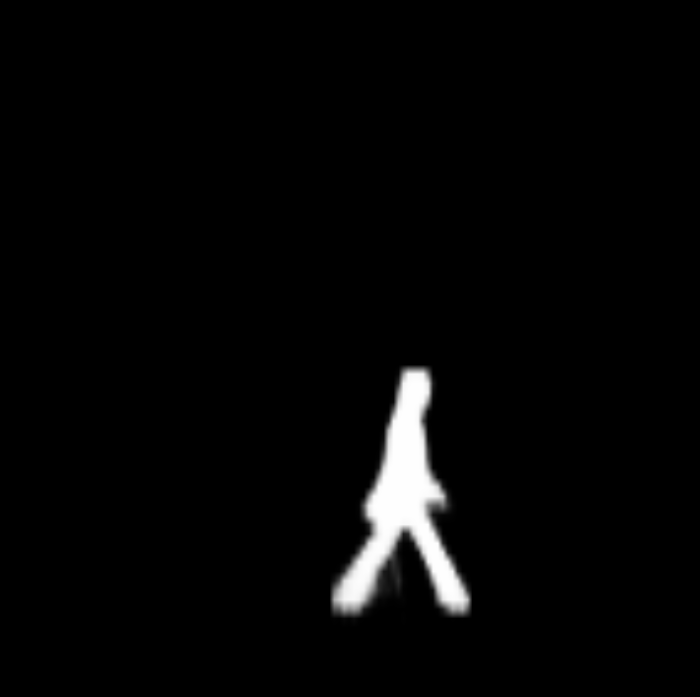

In [161]:
Image.fromarray(prediction[0]['masks'][2, 0].mul(255).byte().cpu().numpy())

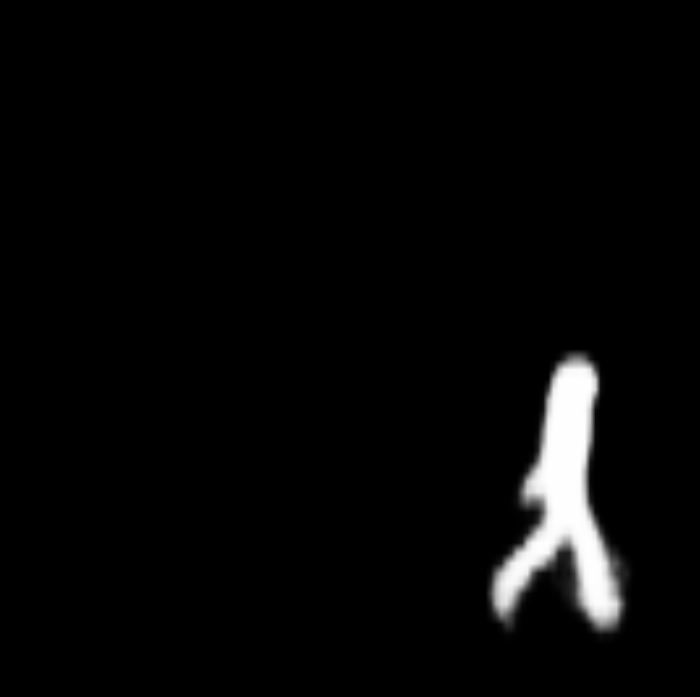

In [162]:
Image.fromarray(prediction[0]['masks'][3, 0].mul(255).byte().cpu().numpy())

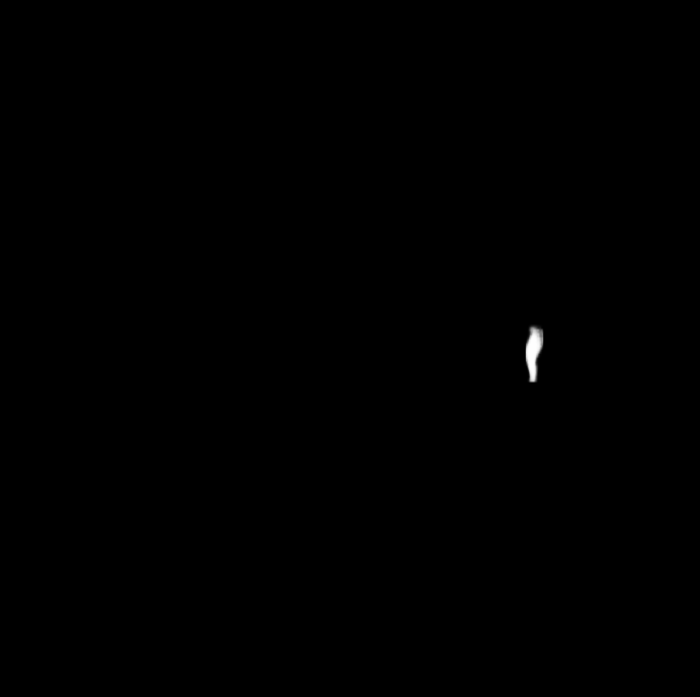

In [163]:
Image.fromarray(prediction[0]['masks'][4, 0].mul(255).byte().cpu().numpy())

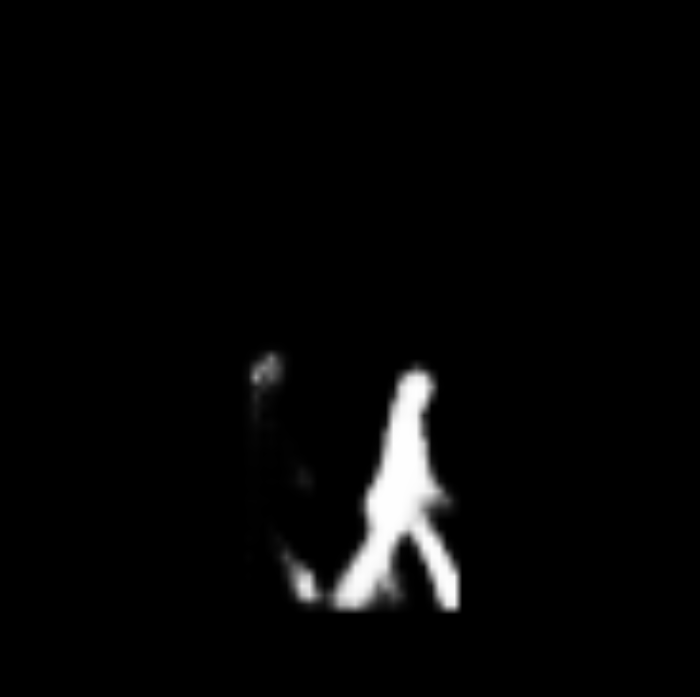

In [164]:
Image.fromarray(prediction[0]['masks'][5, 0].mul(255).byte().cpu().numpy())